### Exercise 5

<div class="alert-success">
    
1. Get a polygons map of the lowest administrative unit possible.
    
2. Get a table of variables for those units. At least 3 numerical variables.

3. Preprocess both tables and get them ready for merging.

4. Do the merging, making the changes needed so that you keep the most rows.
    
    
</div>

In [ ]:
!pip install fiona

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.6/56.6 kB 3.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 17.3/17.3 MB 92.0 MB/s eta 0:00:00


In [ ]:
# data table
import geopandas as gpd
import os

usaDataLink="https://github.com/Derick047/PC6_Parte2/raw/refs/heads/main/Data%20utilizada/usa_counties/usa_counties.gpkg"
gpd.list_layers(usaDataLink)

,name,geometry_type
0,counties,MultiPolygon


In [ ]:
datadisMap = gpd.read_file(usaDataLink, layer='counties')

In [ ]:
datadisMap.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 3235 entries, 0 to 3234
Data columns (total 13 columns):
 #   Column      Non-Null Count  Dtype   
---  ------      --------------  -----   
 0   STATEFP     3235 non-null   object  
 1   COUNTYFP    3235 non-null   object  
 2   COUNTYNS    3235 non-null   object  
 3   AFFGEOID    3235 non-null   object  
 4   GEOID       3235 non-null   object  
 5   NAME        3235 non-null   object  
 6   NAMELSAD    3235 non-null   object  
 7   STUSPS      3235 non-null   object  
 8   STATE_NAME  3235 non-null   object  
 9   LSAD        3235 non-null   object  
 10  ALAND       3235 non-null   int64   
 11  AWATER      3235 non-null   int64   
 12  geometry    3235 non-null   geometry
dtypes: geometry(1), int64(2), object(10)
memory usage: 328.7+ KB


In [ ]:
people_url = "https://github.com/Derick047/PC6_Parte2/raw/main/Data%20utilizada/People.csv"
income_url = "https://github.com/Derick047/PC6_Parte2/raw/main/Data%20utilizada/Income.csv"

In [ ]:
people = pd.read_csv(people_url, encoding="ISO-8859-1")
income = pd.read_csv(income_url, encoding="ISO-8859-1")

In [ ]:
# Verificar columnas
print(people.columns)
print(income.columns)

Index(['FIPS', 'State', 'County', 'Attribute', 'Value'], dtype='object')
Index(['FIPS', 'State', 'County', 'Attribute', 'Value'], dtype='object')


In [ ]:
print(people.columns.to_list())

['FIPS', 'State', 'County', 'Attribute', 'Value']


In [ ]:
# Filtrar atributos específicos
poverty = people[people["Attribute"] == "OwnHomePct"].copy()
poverty["Value"] = pd.to_numeric(poverty["Value"], errors="coerce")
poverty = poverty[["FIPS", "Value"]].rename(columns={"Value": "OwnHomePct"})

income = income[income["Attribute"] == "Median_Household_Income_2021"].copy()
income["Value"] = pd.to_numeric(income["Value"], errors="coerce")
income = income[["FIPS", "Value"]].rename(columns={"Value": "MedianIncome"})

In [ ]:
poverty["FIPS"] = poverty["FIPS"].astype(str).str.zfill(5)
income["FIPS"] = income["FIPS"].astype(str).str.zfill(5)

socio = pd.merge(poverty, income, on="FIPS", how="outer")
counties2 = datadisMap.merge(socio, left_on="GEOID", right_on="FIPS", how="left")

In [ ]:
people["Attribute"].unique()

array(['Age65AndOlderNum2020', 'Age65AndOlderPct2020',
       'AsianNonHispanicNum2020', 'AsianNonHispanicPct2020', 'AvgHHSize',
       'BlackNonHispanicNum2020', 'BlackNonHispanicPct2020',
       'Ed1LessThanHSNum', 'Ed1LessThanHSPct', 'Ed2HSDiplomaOnlyNum',
       'Ed2HSDiplomaOnlyPct', 'Ed3SomeCollegeNum', 'Ed3SomeCollegePct',
       'Ed4AssocDegreeNum', 'Ed4AssocDegreePct', 'Ed5CollegePlusNum',
       'Ed5CollegePlusPct', 'ESTIMATESBASE2020', 'FemaleHHNum',
       'FemaleHHPct', 'ForeignBornAfricaNum', 'ForeignBornAfricaPct',
       'ForeignBornAsiaNum', 'ForeignBornAsiaPct', 'ForeignBornCaribNum',
       'ForeignBornCaribPct', 'ForeignBornCentralSouthAmNum',
       'ForeignBornCentralSouthAmPct', 'ForeignBornEuropeNum',
       'ForeignBornEuropePct', 'ForeignBornMexNum', 'ForeignBornMexPct',
       'ForeignBornNum', 'ForeignBornPct', 'HH65PlusAloneNum',
       'HH65PlusAlonePct', 'HispanicNum2020', 'HispanicPct2020',
       'HispanicPopChangeRate1020', 'LandAreaSQMiles2020',
     

In [ ]:
own_home_df = people[people["Attribute"] == "OwnHomePct"].copy()
own_home_df["Value"] = pd.to_numeric(own_home_df["Value"], errors="coerce")

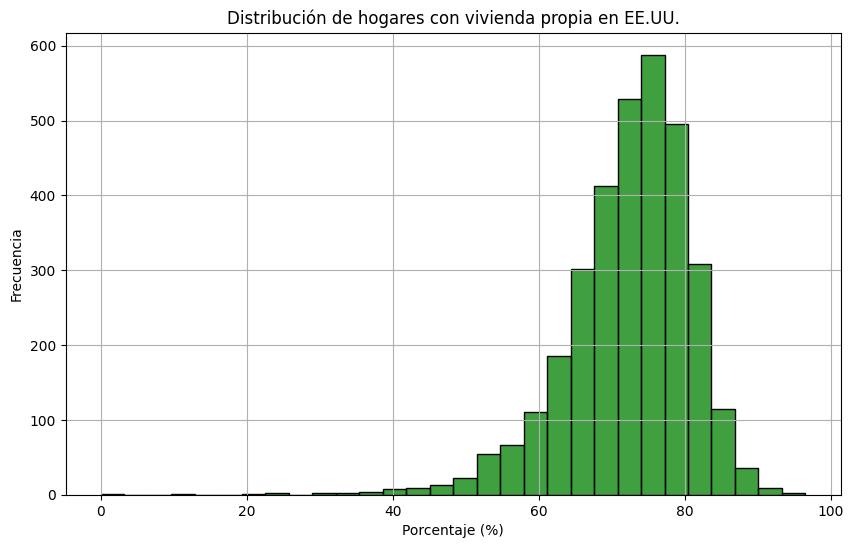

In [ ]:
import seaborn as sea
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 6))
sea.histplot(own_home_df["Value"], color='green', bins=30)
plt.title("Distribución de hogares con vivienda propia en EE.UU.")
plt.xlabel("Porcentaje (%)")
plt.ylabel("Frecuencia")
plt.grid(True)
plt.show()

In [ ]:
import geopandas as gpd
import pandas as pd

# Leer shapefile de condados
usa_link = "https://github.com/Derick047/PC6_Parte2/raw/main/Data%20utilizada/usa_counties/usa_counties.gpkg"
counties = gpd.read_file(usa_link, layer="counties")
counties["GEOID"] = counties["GEOID"].astype(str)

In [ ]:
counties2.columns.to_list()

['STATEFP',
 'COUNTYFP',
 'COUNTYNS',
 'AFFGEOID',
 'GEOID',
 'NAME',
 'NAMELSAD',
 'STUSPS',
 'STATE_NAME',
 'LSAD',
 'ALAND',
 'AWATER',
 'geometry',
 'FIPS',
 'OwnHomePct',
 'MedianIncome']

In [ ]:
!pip install folium matplotlib mapclassify

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 286.7/286.7 kB 14.7 MB/s eta 0:00:00


In [ ]:
counties2.explore(
    column="OwnHomePct",
    scheme="fisherjenks",
    legend=True,
    tooltip=False,
    popup=["NAME", "STATE_NAME", "OwnHomePct"],
    legend_kwds=dict(colorbar=False),
    cmap="Greens"
)

6. Compute the neighbors of the capital city of your country. Plot the results for each of the options.

In [ ]:
from libpysal.weights import Queen, Rook, KNN

# Crear pesos espaciales
w_rook = Rook.from_dataframe(datadisMap)
w_queen = Queen.from_dataframe(datadisMap)
w_knn8 = KNN.from_dataframe(datadisMap, k=8)

/tmp/ipython-input-32-2456757846.py:4: FutureWarning: `use_index` defaults to False but will default to True in future. Set True/False directly to control this behavior and silence this warning
  w_rook = Rook.from_dataframe(datadisMap)
/usr/local/lib/python3.11/dist-packages/libpysal/weights/contiguity.py:61: UserWarning: The weights matrix is not fully connected: 
 There are 26 disconnected components.
 There are 21 islands with ids: 290, 291, 470, 471, 746, 754, 917, 918, 919, 1023, 1047, 1116, 1137, 1286, 1479, 1506, 1644, 1702, 2758, 2946, 3210.
  W.__init__(self, neighbors, ids=ids, **kw)
/tmp/ipython-input-32-2456757846.py:5: FutureWarning: `use_index` defaults to False but will default to True in future. Set True/False directly to control this behavior and silence this warning
  w_queen = Queen.from_dataframe(datadisMap)
/usr/local/lib/python3.11/dist-packages/libpysal/weights/contiguity.py:347: UserWarning: The weights matrix is not fully connected: 
 There are 26 disconnected

In [ ]:
# Revisar islas (condados sin vecinos contiguos)
print("Islas en Queen:", w_queen.islands)

# Encontrar índice del condado de Washington D.C.
idx_dc = datadisMap[datadisMap['NAME'] == "District of Columbia"].index[0]

Islas en Queen: [290, 291, 470, 471, 746, 754, 917, 918, 919, 1023, 1047, 1116, 1137, 1286, 1479, 1506, 1644, 1702, 2758, 2946, 3210]


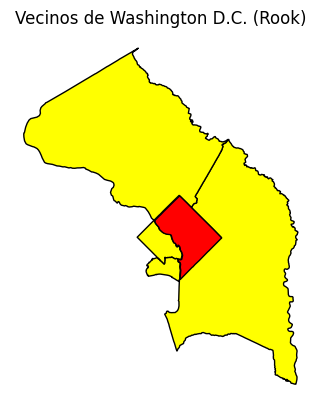

In [ ]:
# Visualizar vecinos con Rook
import matplotlib.pyplot as plt

neighbors_rook = w_rook.neighbors[idx_dc]
base = datadisMap.iloc[neighbors_rook].plot(color='yellow', edgecolor='black')
datadisMap.loc[[idx_dc]].plot(ax=base, color='red', edgecolor='black')
plt.title("Vecinos de Washington D.C. (Rook)")
plt.axis("off")
plt.show()

7. - Compute the Moran's coefficient for one of your three numeric variables.

   - Make a scatter plot for each variable.

In [ ]:
!pip install esda splot libpysal geopandas mapclassify

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 142.8/142.8 kB 9.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 61.3/61.3 kB 4.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 389.9/389.9 kB 24.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 322.8/322.8 kB 21.7 MB/s eta 0:00:00


In [ ]:
!pip install contextily

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 22.2/22.2 MB 58.0 MB/s eta 0:00:00


In [ ]:
import geopandas as gpd
import pandas as pd
import matplotlib.pyplot as plt
from libpysal.weights import KNN
from esda.moran import Moran, Moran_Local
from splot.esda import moran_scatterplot

In [ ]:
# Variable a analizar
var = 'MedHHInc'  # Puedes cambiarla por 'PCTPOVALL' o 'Ed5CollegePlusPct'

In [ ]:
# Verificar existencia
if var not in datadisMap.columns:
    raise ValueError(f"La columna '{var}' no existe. Revisa: {datadisMap.columns.tolist()}")

# Eliminar valores nulos
datadisMap = datadisMap[~datadisMap[var].isna()]

In [ ]:
# Construir matriz de vecinos con KNN (k=8)
w_knn8 = KNN.from_dataframe(datadisMap, k=8)
w_knn8.transform = 'R'  # Normalizar por filas

Moran's I: 0.5577, p-value: 0.0010


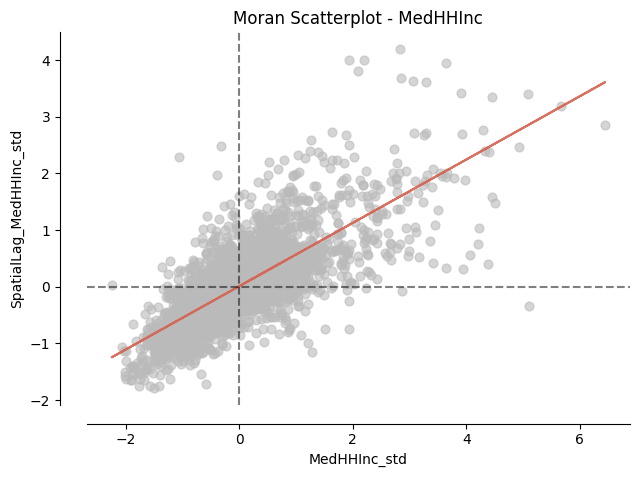

In [ ]:
# ---- MORAN GLOBAL ----
moran_global = Moran(datadisMap[var], w_knn8)
print(f"Moran's I: {moran_global.I:.4f}, p-value: {moran_global.p_sim:.4f}")

# Scatterplot de Moran
fig, ax = moran_scatterplot(moran_global, aspect_equal=True)
ax.set_title(f"Moran Scatterplot - {var}")
ax.set_xlabel(f"{var}_std")
ax.set_ylabel(f"SpatialLag_{var}_std")
plt.show()

In [ ]:
# ---- MORAN LOCAL (LISA) ----
lisa = Moran_Local(datadisMap[var], w_knn8, seed=1234)

# Clasificación de cuadrantes
datadisMap['quad'] = [q if p < 0.05 else 0 for q, p in zip(lisa.q, lisa.p_sim)]
labels = ['0 no_sig', '1 hotSpot', '2 coldOutlier', '3 coldSpot', '4 hotOutlier']
datadisMap['quad_name'] = [labels[q] for q in datadisMap['quad']]

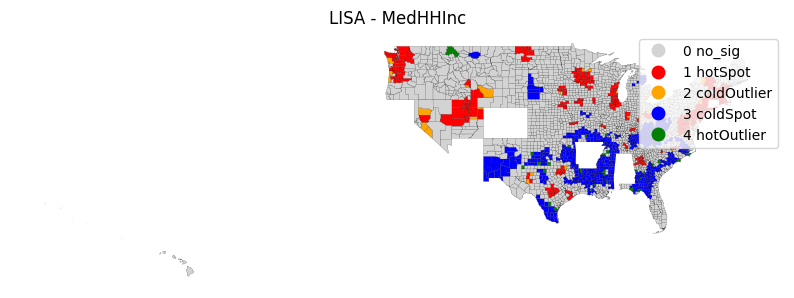

In [ ]:
# Colores personalizados
from matplotlib import colors
cmap = colors.ListedColormap(['lightgrey', 'red', 'orange', 'blue', 'green'])

# Mapa
fig, ax = plt.subplots(1, 1, figsize=(10, 10))
datadisMap.plot(column='quad_name', cmap=cmap, legend=True, edgecolor='k', linewidth=0.1, ax=ax)
ax.set_title(f"LISA - {var}")
ax.set_axis_off()
plt.show()

8. - Compute the Local Moran for the variables in your data that have significant spatial correlation.

- Create a new column for each of those variables, with a label ('0 no_sig', '1 hotSpot', '2 coldOutlier', '3 coldSpot', '4 hotOutlier').

- Prepare a map for each of the variables analyzed, showing the spots and outliers.

In [ ]:
from esda.moran import Moran_Local
from splot.esda import moran_scatterplot
import matplotlib.pyplot as plt
from matplotlib import colors

# Lista de variables a analizar
variables = ['MedHHInc', 'PCTPOVALL', 'Ed5CollegePlusPct']

# Colormap personalizado
my_colors = colors.ListedColormap(['lightgrey', 'red', 'orange', 'blue', 'green'])
labels = ['0 no_sig', '1 hotSpot', '2 coldOutlier', '3 coldSpot', '4 hotOutlier']


---- LISA para MedHHInc ----
MedHHInc_quad_label
0 no_sig         1774
3 coldSpot        622
1 hotSpot         356
2 coldOutlier      41
4 hotOutlier       32
Name: count, dtype: int64


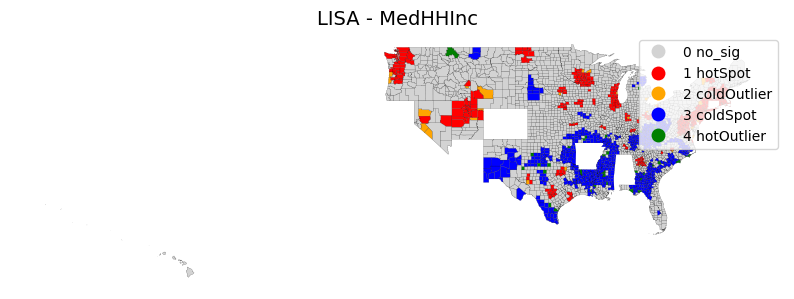


---- LISA para PCTPOVALL ----
PCTPOVALL_quad_label
0 no_sig         1576
3 coldSpot        671
1 hotSpot         465
4 hotOutlier       68
2 coldOutlier      45
Name: count, dtype: int64


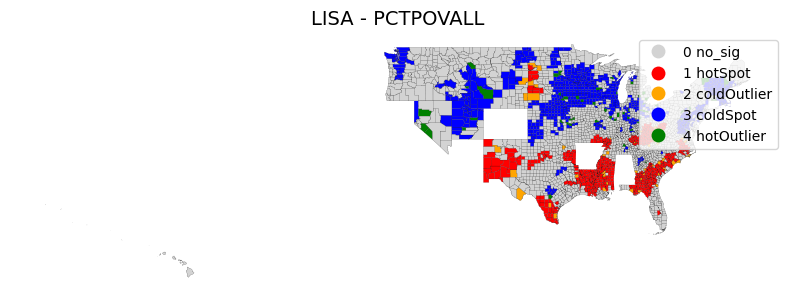


---- LISA para Ed5CollegePlusPct ----
Ed5CollegePlusPct_quad_label
0 no_sig         1887
3 coldSpot        479
1 hotSpot         324
4 hotOutlier       74
2 coldOutlier      61
Name: count, dtype: int64


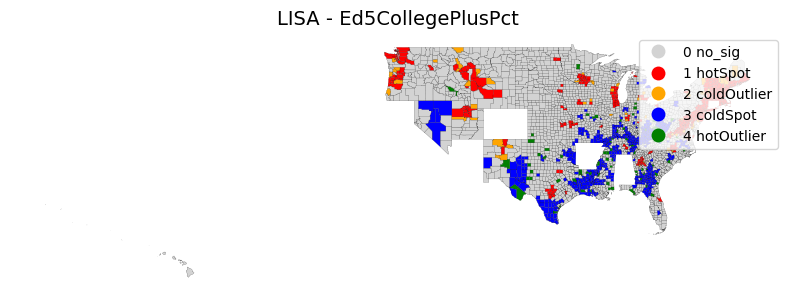

In [ ]:
for var in variables:
    print(f"\n---- LISA para {var} ----")

    # Asegurar que no hay NaNs
    data = datadisMap[[var, 'geometry']].dropna()

    # Calcular LISA
    lisa = Moran_Local(data[var], w_knn8, seed=42)

    # Agregar resultados al GeoDataFrame original
    datadisMap[f'{var}_quad'] = [q if p < 0.05 else 0 for q, p in zip(lisa.q, lisa.p_sim)]
    datadisMap[f'{var}_quad_label'] = [labels[q] for q in datadisMap[f'{var}_quad']]

    # Mostrar distribución de categorías
    print(datadisMap[f'{var}_quad_label'].value_counts())

    # Plot
    fig, ax = plt.subplots(1, 1, figsize=(10, 10))
    datadisMap.plot(
        column=f'{var}_quad_label',
        cmap=my_colors,
        categorical=True,
        legend=True,
        edgecolor='k',
        linewidth=0.1,
        ax=ax
    )
    ax.set_title(f'LISA - {var}', fontsize=14)
    ax.set_axis_off()
    plt.show()

9. Use your three variables to carry out the cluster/regional analysis.

In [ ]:
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import AgglomerativeClustering
from scipy.cluster import hierarchy
from esda import shape as shapestats
from sklearn import metrics
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import pandas as pd

# Variables seleccionadas
vars_cluster = ['Under18Pct2020', 'OwnHomePct', 'FemaleHHPct']

In [ ]:
# 1. Normalizar
scaler = StandardScaler()
X_scaled = scaler.fit_transform(datadisMap[vars_cluster].dropna())

# Nombres de columnas normalizadas
vars_std = [var + '_std' for var in vars_cluster]
datadisMap[vars_std] = X_scaled


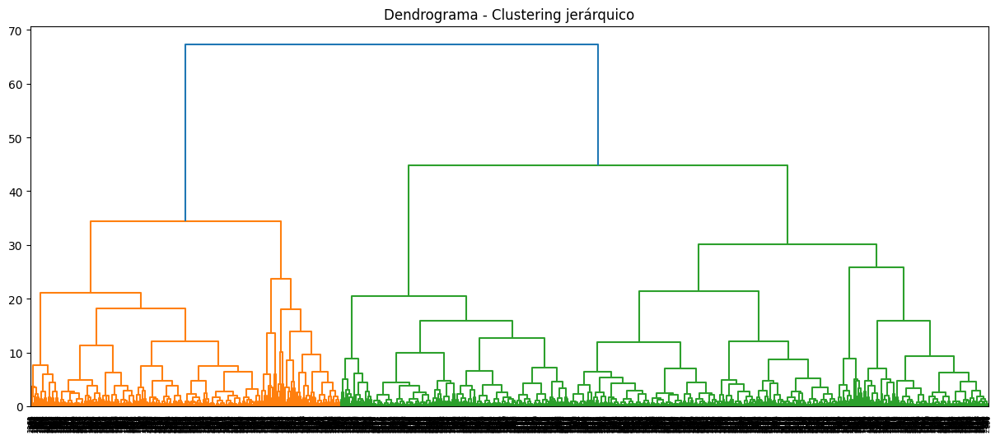

In [ ]:
# 2. Dendrograma para ver número de clusters sugeridos
Z = hierarchy.linkage(X_scaled, method='ward')
plt.figure(figsize=(15, 6))
plt.title("Dendrograma - Clustering jerárquico")
hierarchy.dendrogram(Z, leaf_rotation=90., leaf_font_size=6)
plt.show()

In [ ]:
# 3. Clustering sin restricción espacial
agnes = AgglomerativeClustering(n_clusters=6, linkage='ward')
datadisMap['hc_ag6_other'] = agnes.fit_predict(X_scaled)

# 4. Clustering con restricción espacial (KNN8)
agnes_spatial = AgglomerativeClustering(n_clusters=6, linkage='ward', connectivity=w_knn8.sparse)
datadisMap['hc_ag6_spatial'] = agnes_spatial.fit_predict(X_scaled)

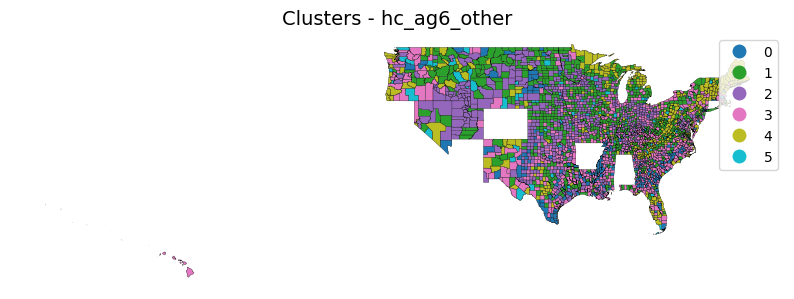

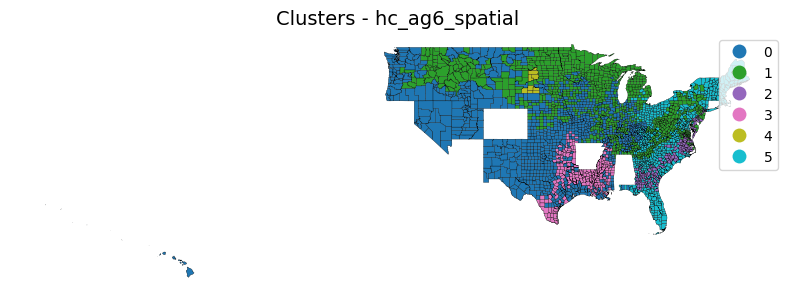

In [ ]:
# 5. Graficar agrupaciones
for col in ['hc_ag6_other', 'hc_ag6_spatial']:
    f, ax = plt.subplots(1, 1, figsize=(10, 10))
    datadisMap.plot(
        column=col,
        categorical=True,
        legend=True,
        ax=ax,
        edgecolor='k',
        linewidth=0.2
    )
    ax.set_title(f'Clusters - {col}', fontsize=14)
    ax.set_axis_off()
    plt.show()

In [ ]:
# 6. Comparación de formas de los clusters (Isoperimetric Quotient)
results_shape = {}
for cluster_col in ['hc_ag6_other', 'hc_ag6_spatial']:
    dissolved = datadisMap[[cluster_col, 'geometry']].to_crs(24892).dissolve(by=cluster_col)
    ipq = shapestats.isoperimetric_quotient(dissolved)
    results_shape[cluster_col] = ipq

print("\n Isoperimetric Quotient (compactación):")
print(pd.DataFrame(results_shape))


 Isoperimetric Quotient (compactación):
   hc_ag6_other  hc_ag6_spatial
0      0.003889        0.007647
1      0.002004        0.005633
2      0.002895        0.010802
3      0.001756        0.013998
4      0.003131        0.198662
5      0.007916        0.006903


In [ ]:
# 7. Validación de calidad del clustering
fit_scores = []
for col in ['hc_ag6_other', 'hc_ag6_spatial']:
    ch_score = metrics.calinski_harabasz_score(X_scaled, datadisMap[col])
    sil_score = metrics.silhouette_score(X_scaled, datadisMap[col])
    fit_scores.append((col, ch_score, sil_score))

print("\n📊 Calinski-Harabasz & Silhouette:")
print(pd.DataFrame(fit_scores, columns=['Cluster type', 'CH Score', 'Silhouette']).set_index('Cluster type'))


📊 Calinski-Harabasz & Silhouette:
                  CH Score  Silhouette
Cluster type                          
hc_ag6_other    685.678821    0.166298
hc_ag6_spatial  256.785412    0.032415


10. Use your three variables to carry out regression analysis (conventional and spatial).

In [ ]:
!pip install pysal

  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 47.9/47.9 kB 3.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.7/1.7 MB 61.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 59.2/59.2 kB 4.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 141.6/141.6 kB 11.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 53.9/53.9 kB 3.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 41.4/41.4 kB 2.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 243.1/243.1 kB 15.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 16.4/16.4 MB 68.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 541.1/541.1 kB 33.7 MB/s eta 0:00:00
  Created wheel for spint: filename=spint-1.0.7-py3-none-any.whl size=31354 sha256=8611e6285a4a8a87b961eb501a999e93bd42382b156c0895d021622134b7e620
  Stored in directory: /root/.cache/pip/wheels/32/dc/2e/400caaa67e697355772a82b77b8c2ac7cd61633f595c

In [ ]:
!pip install esda splot

In [ ]:
from pysal.model import spreg
from esda.moran import Moran

# Variables independientes y dependiente
dep_var_name = ['Ed1LessThanHSPct']
indep_vars_names = ['Under18Pct2020', 'OwnHomePct', 'FemaleHHPct']
labels = ['% sin secundaria', '% <18 años', '% propietarios', '% jefatura femenina']

In [ ]:
# Verificar que no haya NaNs
datadisMap = datadisMap.dropna(subset=dep_var_name + indep_vars_names)

In [ ]:
# OLS - Regresión Convencional
ols_model = spreg.OLS(
    y=datadisMap[dep_var_name].values,
    x=datadisMap[indep_vars_names].values,
    name_y=labels[0],
    name_x=labels[1:],
    name_ds='datadisMap'
)

print(" OLS - Regresión Lineal Convencional")
print(ols_model.summary)

 OLS - Regresión Lineal Convencional
REGRESSION RESULTS
------------------

SUMMARY OF OUTPUT: ORDINARY LEAST SQUARES
-----------------------------------------
Data set            :  datadisMap
Weights matrix      :        None
Dependent Variable  :% sin secundaria                Number of Observations:        2825
Mean dependent var  :     11.9798                Number of Variables   :           4
S.D. dependent var  :      6.0296                Degrees of Freedom    :        2821
R-squared           :      0.2567
Adjusted R-squared  :      0.2559
Sum squared residual:     76313.1                F-statistic           :    324.7566
Sigma-square        :      27.052                Prob(F-statistic)     :   4.02e-181
S.E. of regression  :       5.201                Log likelihood        :   -8664.577
Sigma-square ML     :      27.013                Akaike info criterion :   17337.154
S.E of regression ML:      5.1975                Schwarz criterion     :   17360.939

-------------------

In [ ]:
#  Moran del residuo del modelo (para ver si hay autocorrelación)
moran_residuals = Moran(ols_model.u, w_knn8)
print(f"\nMoran del error (OLS residuals): I = {moran_residuals.I:.4f}, p = {moran_residuals.p_sim:.4f}")


Moran del error (OLS residuals): I = 0.4102, p = 0.0010


In [ ]:
ser_model = spreg.ML_Error(
    y=datadisMap[dep_var_name].values,
    x=datadisMap[indep_vars_names].values,
    w=w_knn8,
    name_y=labels[0],
    name_x=labels[1:],
    name_w='KNN8',
    name_ds='datadisMap'
)
print("SER - Spatial Error Model")
print(ser_model.summary)

/usr/local/lib/python3.11/dist-packages/spreg/ml_error.py:184: RuntimeWarning: Method 'bounded' does not support relative tolerance in x; defaulting to absolute tolerance.
  res = minimize_scalar(


SER - Spatial Error Model
REGRESSION RESULTS
------------------

SUMMARY OF OUTPUT: ML SPATIAL ERROR (METHOD = full)
---------------------------------------------------
Data set            :  datadisMap
Weights matrix      :        KNN8
Dependent Variable  :% sin secundaria                Number of Observations:        2825
Mean dependent var  :     11.9798                Number of Variables   :           4
S.D. dependent var  :      6.0296                Degrees of Freedom    :        2821
Pseudo R-squared    :      0.2567
Log likelihood      :  -8092.3851
Sigma-square ML     :     16.4431                Akaike info criterion :   16192.770
S.E of regression   :      4.0550                Schwarz criterion     :   16216.555

------------------------------------------------------------------------------------
            Variable     Coefficient       Std.Error     z-Statistic     Probability
------------------------------------------------------------------------------------
          

In [ ]:
lag_model = spreg.ML_Lag(
    y=datadisMap[dep_var_name].values,
    x=datadisMap[indep_vars_names].values,
    w=w_knn8,
    name_y=labels[0],
    name_x=labels[1:],
    name_w='KNN8',
    name_ds='datadisMap'
)

print(" Spatial Lag Model")
print(lag_model.summary)

 Spatial Lag Model
REGRESSION RESULTS
------------------

SUMMARY OF OUTPUT: MAXIMUM LIKELIHOOD SPATIAL LAG (METHOD = FULL)
-----------------------------------------------------------------
Data set            :  datadisMap
Weights matrix      :        KNN8
Dependent Variable  :% sin secundaria                Number of Observations:        2825
Mean dependent var  :     11.9798                Number of Variables   :           5
S.D. dependent var  :      6.0296                Degrees of Freedom    :        2820
Pseudo R-squared    :      0.5456
Spatial Pseudo R-squared:  0.3058
Log likelihood      :  -8083.3486
Sigma-square ML     :     16.6581                Akaike info criterion :   16176.697
S.E of regression   :      4.0814                Schwarz criterion     :   16206.428

------------------------------------------------------------------------------------
            Variable     Coefficient       Std.Error     z-Statistic     Probability
----------------------------------------

/usr/local/lib/python3.11/dist-packages/geopandas/plotting.py:956: UserWarning: Glyph 128308 (\N{LARGE RED CIRCLE}) missing from font(s) DejaVu Sans.
  ax.figure.canvas.draw_idle()
/tmp/ipython-input-98-2524109213.py:36: UserWarning: Glyph 128309 (\N{LARGE BLUE CIRCLE}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.11/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 128308 (\N{LARGE RED CIRCLE}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.11/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 128309 (\N{LARGE BLUE CIRCLE}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


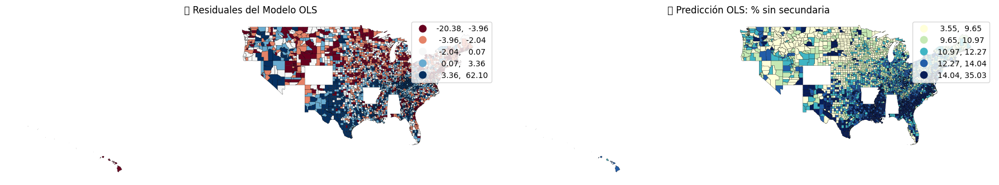

In [ ]:
import matplotlib.pyplot as plt

# Añadir residuos y predicciones al GeoDataFrame
datadisMap["OLS_resid"] = ols_model.u.flatten()
datadisMap["OLS_pred"] = ols_model.predy.flatten()

# Mapa de residuos
fig, ax = plt.subplots(1, 2, figsize=(18, 8))

# Residuos
datadisMap.plot(
    column="OLS_resid",
    cmap="RdBu",
    scheme="quantiles",
    legend=True,
    ax=ax[0],
    edgecolor='black',
    linewidth=0.2
)
ax[0].set_title("🔴 Residuales del Modelo OLS")
ax[0].axis("off")

# Predicciones
datadisMap.plot(
    column="OLS_pred",
    cmap="YlGnBu",
    scheme="quantiles",
    legend=True,
    ax=ax[1],
    edgecolor='black',
    linewidth=0.2
)
ax[1].set_title("🔵 Predicción OLS: % sin secundaria")
ax[1].axis("off")

plt.tight_layout()
plt.show()